# RetinaNet Auto-Annotator

Author: Andrew Shepley Contact: asheple2@une.edu.au Source: U-Infuse Purpose: (a) choose multi-class or single class auto-annotation (b) generate 1 xml file per image 

In [1]:
from inference import *
from preprocessing import *
from auto_annotation import *

%matplotlib inline
%load_ext autoreload
%autoreload 2

# use this environment flag to change which GPU to use
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

Using TensorFlow backend.


In [3]:
#use this to populate the 'Images to Annotate' dropdown - users can only annotate images that they place in ../datasets 
get_all_datasets('../datasets')

['cat', 'car', 'kangaroo', 'dog', 'raw_ims', 'trap_kangaroos']

In [15]:
#user chooses one of the datasets, e.g. raw_ims
folder = 'trap_kangaroos/'

In [16]:
#choose multi-class or not. Link to checkbox at the top.
multi_class = False
model_dir = './pretrained_models/'

In [17]:
#if multi-class is False, ALWAYS use the default retinanet foreground object detector. 
#User must specify class name.
chosen_model = 'single_class_annotator.h5'

#link classes set below to user textbox (class, e.g. cow) - only for single class
classes = {"kangaroo"} 

In [6]:
#If multi_class is True, populate 'select annotator' dropdown list user options (all trained models) 
get_all_files(model_dir, 'h5')

['pretrained_COCO.h5',
 '3_classes.h5',
 'my_first_model.h5',
 'kangaroo_model.h5',
 'testModel.h5',
 'single_class_annotator.h5']

In [7]:
#If multi_class is True, user chooses one of the above
chosen_model = 'my_first_model.h5'

In [18]:
#if multi_class is true or false, perform this step
model = choose_inference_model(model_dir, chosen_model)
class_mapping_file = os.path.join(model_dir,chosen_model[:-2]+"csv")

tracking <tf.Variable 'Variable_5:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_6:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_7:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_8:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_9:0' shape=(9, 4) dtype=float32> anchors


In [19]:
#this will generate the relevant class mapping file based on user's chosen class
write_class_file(class_mapping_file, classes)

In [20]:
#link to confidence threshold textbox
user_selected_confidence = 50
confidence_threshold = set_confidence_threshold(user_selected_confidence) 

In [21]:
unannotated_dataset = os.path.join('../datasets',folder)

In [22]:
#this is the list of images that will be passed into the annotation model
images_to_annotate = generate_list_of_images(unannotated_dataset) 

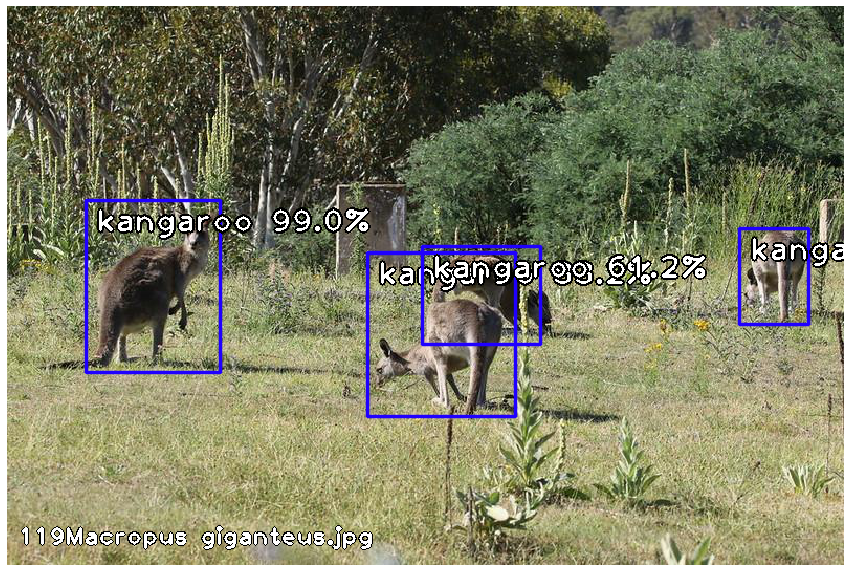

In [23]:
#process each image just like in the preview model window, e.g. 
image_0 = images_to_annotate[0]
#perform object detection as usual
processed_image, object_detection_data = inference_per_image(unannotated_dataset, model, image_0, class_mapping_file, confidence_threshold)
#create an annotation object = use class RetinaNet_Auto_Annotator()
annotation_0 = RetinaNet_Auto_Annotator(unannotated_dataset, image_0, object_detection_data, processed_image.shape,confidence_threshold)
#write the xml file for this image
annotation_0.write_xml_file()

#displays image
img = Image.fromarray(processed_image, 'RGB')
plt.figure(figsize=(15, 15))
plt.axis('off')
plt.imshow(img)
plt.show()

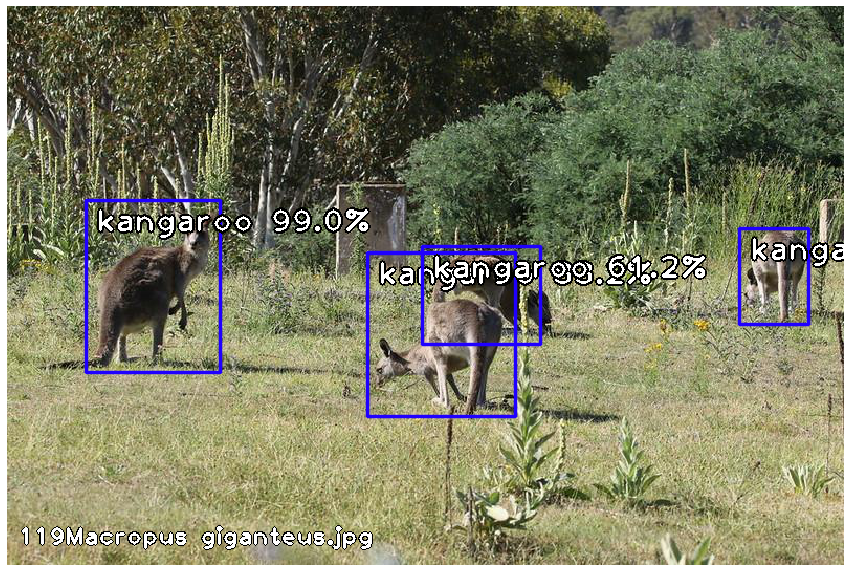

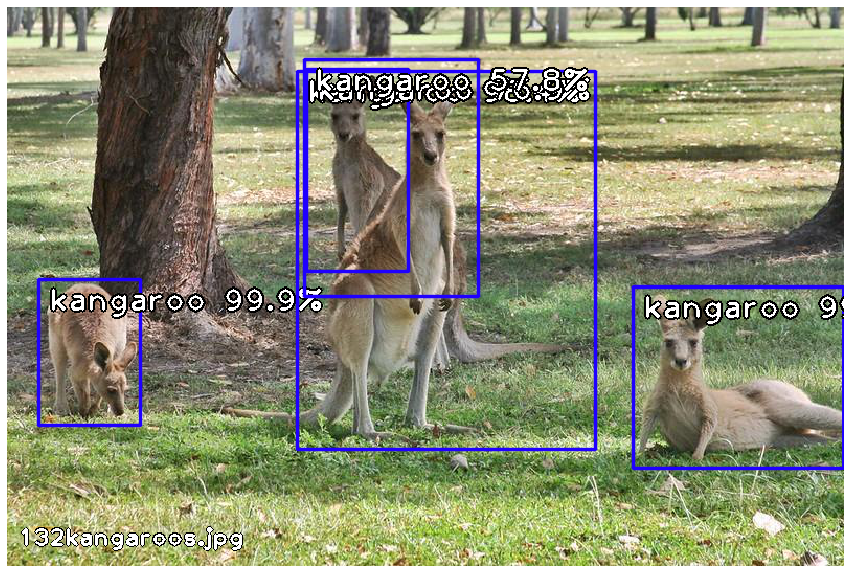

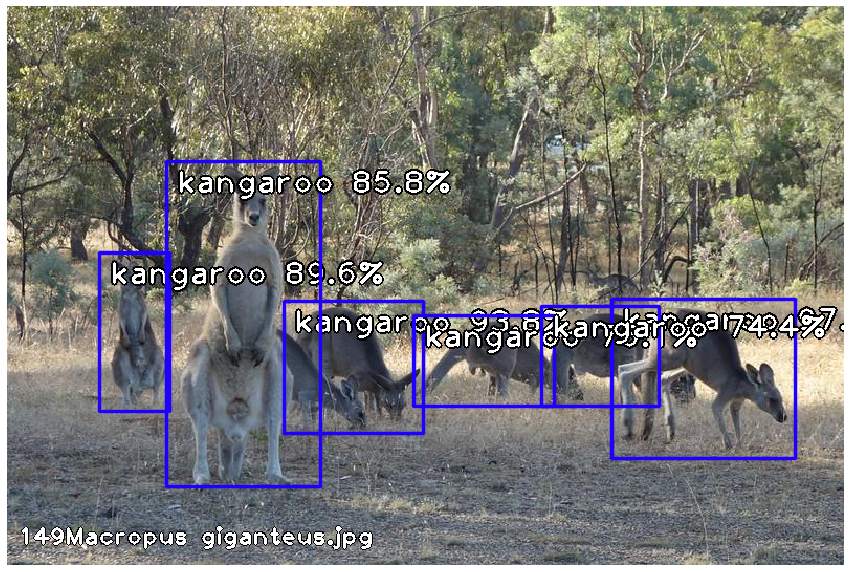

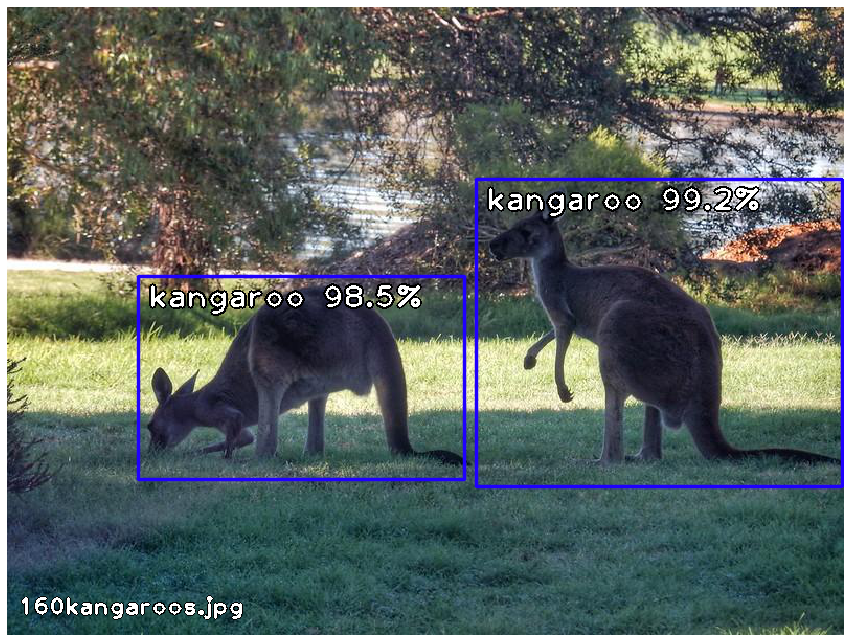

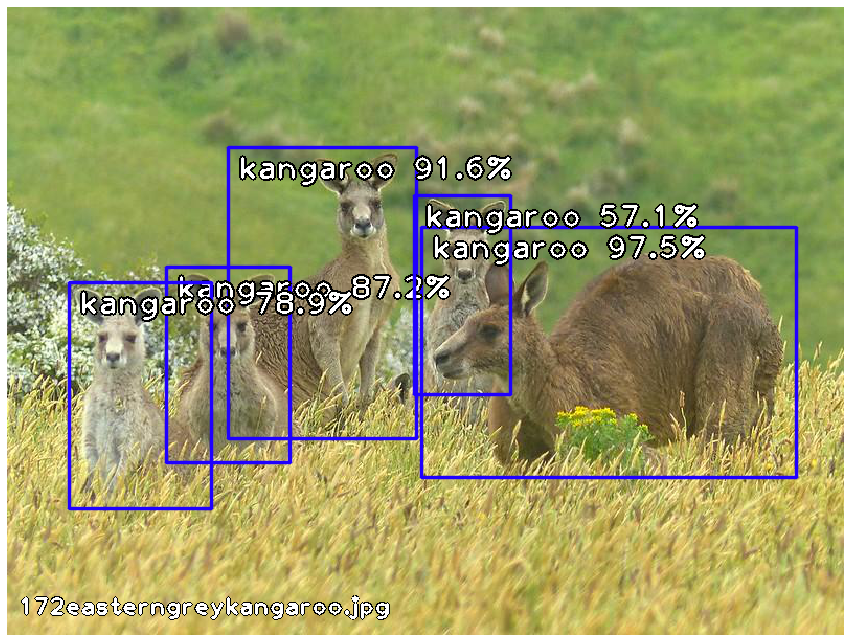

...

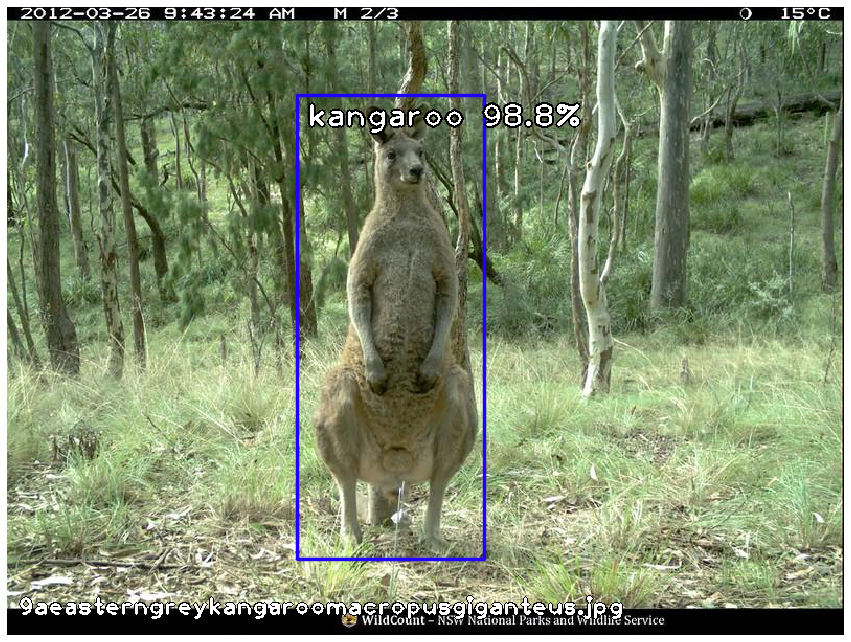

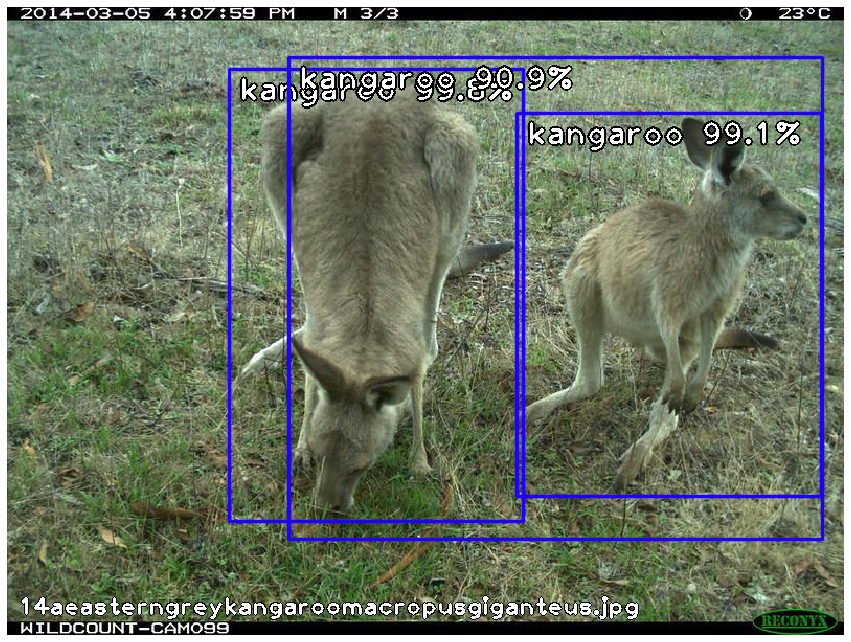

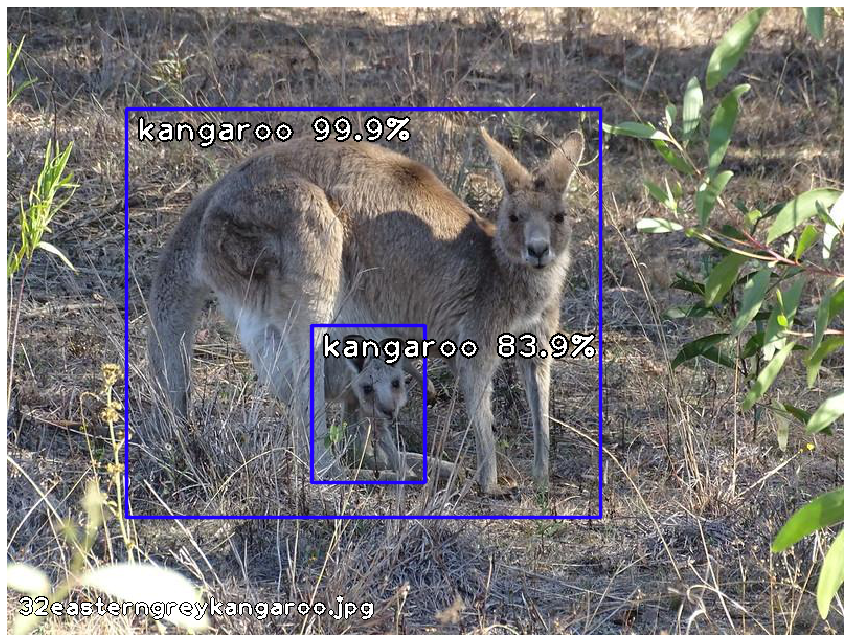

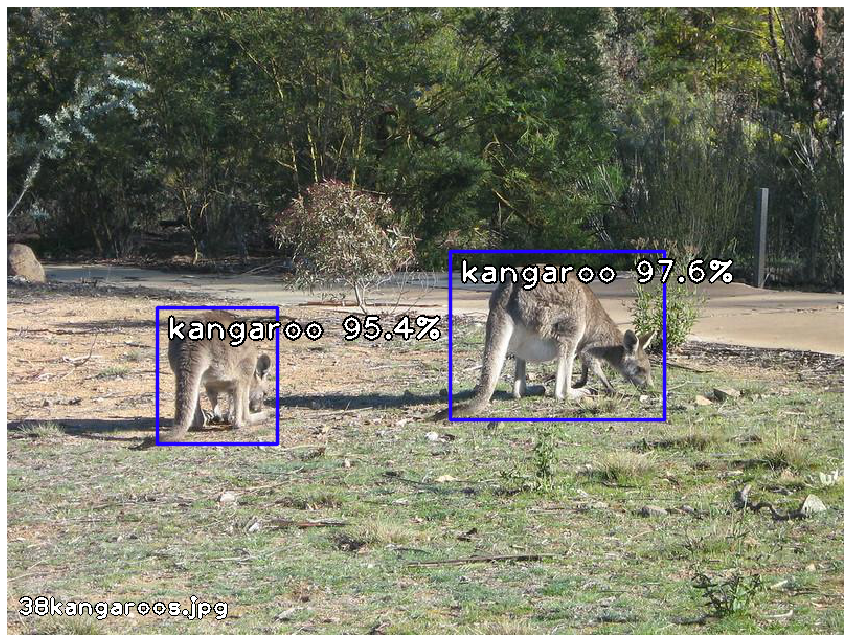

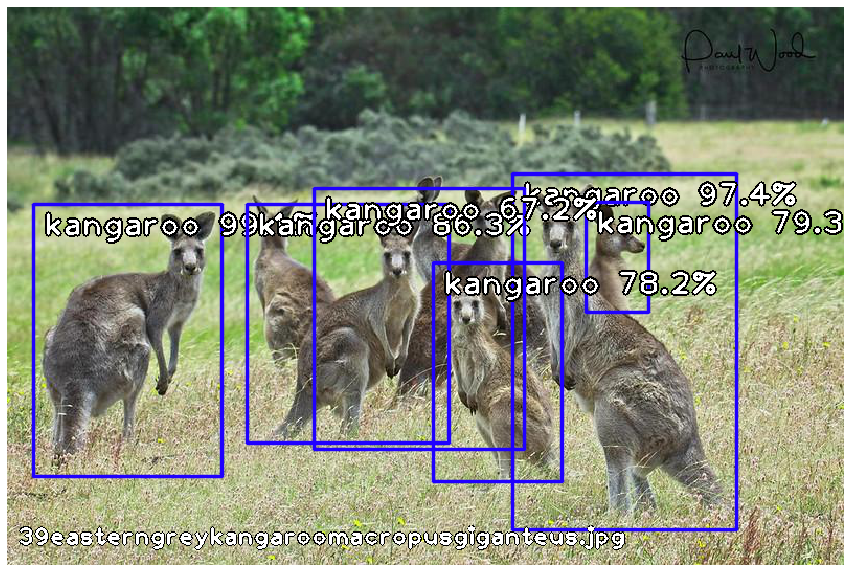

In [24]:
#OR do it all in a loop
for each_im in images_to_annotate:
    #perform object detection as usual
    processed_image, object_detection_data = inference_per_image(unannotated_dataset, model, each_im, class_mapping_file, confidence_threshold)
    #create an annotation object = use class RetinaNet_Auto_Annotator()
    annotation = RetinaNet_Auto_Annotator(unannotated_dataset, each_im, object_detection_data, processed_image.shape, confidence_threshold)
    #write the xml file for this image
    annotation.write_xml_file()
  
    #displays image
    img = Image.fromarray(processed_image, 'RGB')
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    plt.imshow(img)
    plt.show()